In [1]:
import pandas as pd

df = pd.read_csv('GBPJPY_M15.csv')
df

,time,open,high,low,close
0,2021-01-04 00:00:00,140.732,141.004,140.717,140.896
1,2021-01-04 00:15:00,140.896,141.047,140.872,140.968
2,2021-01-04 00:30:00,140.968,140.968,140.888,140.906
3,2021-01-04 00:45:00,140.906,140.989,140.898,140.954
4,2021-01-04 01:00:00,140.966,141.120,140.966,141.108
...,...,...,...,...,...
69233,2023-10-11 20:45:00,183.315,183.392,183.253,183.313
69234,2023-10-11 21:00:00,183.315,183.473,183.225,183.437
69235,2023-10-11 21:15:00,183.444,183.531,183.420,183.515
69236,2023-10-11 21:30:00,183.517,183.571,183.509,183.565


In [2]:
# calculate the range of the asian session 00:00 - 08:00 GMT+0

def get_session(hour):
    if 0 <= hour < 8:
        return 'asian session'
    else:
        None

df['time'] = pd.to_datetime(df['time'])
df['hour'] = df['time'].dt.hour
df['session'] = df['hour'].apply(get_session)

df['date'] = df['time'].dt.date

df

,time,open,high,low,close,hour,session,date
0,2021-01-04 00:00:00,140.732,141.004,140.717,140.896,0,asian session,2021-01-04
1,2021-01-04 00:15:00,140.896,141.047,140.872,140.968,0,asian session,2021-01-04
2,2021-01-04 00:30:00,140.968,140.968,140.888,140.906,0,asian session,2021-01-04
3,2021-01-04 00:45:00,140.906,140.989,140.898,140.954,0,asian session,2021-01-04
4,2021-01-04 01:00:00,140.966,141.120,140.966,141.108,1,asian session,2021-01-04
...,...,...,...,...,...,...,...,...
69233,2023-10-11 20:45:00,183.315,183.392,183.253,183.313,20,None,2023-10-11
69234,2023-10-11 21:00:00,183.315,183.473,183.225,183.437,21,None,2023-10-11
69235,2023-10-11 21:15:00,183.444,183.531,183.420,183.515,21,None,2023-10-11
69236,2023-10-11 21:30:00,183.517,183.571,183.509,183.565,21,None,2023-10-11


In [3]:
df_by_date = df.groupby(['date', 'session'], as_index=False).agg(
    session_high=('high', 'max'),
    session_low=('low', 'min')
)

df_by_date

,date,session,session_high,session_low
0,2021-01-04,asian session,141.311,140.717
1,2021-01-05,asian session,140.152,139.829
2,2021-01-06,asian session,140.031,139.791
3,2021-01-07,asian session,140.553,140.107
4,2021-01-08,asian session,140.959,140.737
...,...,...,...,...
717,2023-10-05,asian session,180.960,180.290
718,2023-10-06,asian session,181.188,180.795
719,2023-10-09,asian session,182.315,181.819
720,2023-10-10,asian session,182.039,181.544


In [4]:
df = df.merge(df_by_date, on=['date'], how='left')
df

,time,open,high,low,close,hour,session_x,date,session_y,session_high,session_low
0,2021-01-04 00:00:00,140.732,141.004,140.717,140.896,0,asian session,2021-01-04,asian session,141.311,140.717
1,2021-01-04 00:15:00,140.896,141.047,140.872,140.968,0,asian session,2021-01-04,asian session,141.311,140.717
2,2021-01-04 00:30:00,140.968,140.968,140.888,140.906,0,asian session,2021-01-04,asian session,141.311,140.717
3,2021-01-04 00:45:00,140.906,140.989,140.898,140.954,0,asian session,2021-01-04,asian session,141.311,140.717
4,2021-01-04 01:00:00,140.966,141.120,140.966,141.108,1,asian session,2021-01-04,asian session,141.311,140.717
...,...,...,...,...,...,...,...,...,...,...,...
69233,2023-10-11 20:45:00,183.315,183.392,183.253,183.313,20,None,2023-10-11,asian session,183.019,182.468
69234,2023-10-11 21:00:00,183.315,183.473,183.225,183.437,21,None,2023-10-11,asian session,183.019,182.468
69235,2023-10-11 21:15:00,183.444,183.531,183.420,183.515,21,None,2023-10-11,asian session,183.019,182.468
69236,2023-10-11 21:30:00,183.517,183.571,183.509,183.565,21,None,2023-10-11,asian session,183.019,182.468


In [5]:
# Strategy Backtest Rules

# 1) Allowed entry is between 08:00 - 12:00 after M15 close which breaks out of the range
# 2) Stop Loss will be set in the middle of the range
# 3) Trade will be close at the end of the EU session at 17:00

df['stoploss'] = df['session_high'] - (df['session_high'] - df['session_low']) / 2
df

,time,open,high,low,close,hour,session_x,date,session_y,session_high,session_low,stoploss
0,2021-01-04 00:00:00,140.732,141.004,140.717,140.896,0,asian session,2021-01-04,asian session,141.311,140.717,141.0140
1,2021-01-04 00:15:00,140.896,141.047,140.872,140.968,0,asian session,2021-01-04,asian session,141.311,140.717,141.0140
2,2021-01-04 00:30:00,140.968,140.968,140.888,140.906,0,asian session,2021-01-04,asian session,141.311,140.717,141.0140
3,2021-01-04 00:45:00,140.906,140.989,140.898,140.954,0,asian session,2021-01-04,asian session,141.311,140.717,141.0140
4,2021-01-04 01:00:00,140.966,141.120,140.966,141.108,1,asian session,2021-01-04,asian session,141.311,140.717,141.0140
...,...,...,...,...,...,...,...,...,...,...,...,...
69233,2023-10-11 20:45:00,183.315,183.392,183.253,183.313,20,None,2023-10-11,asian session,183.019,182.468,182.7435
69234,2023-10-11 21:00:00,183.315,183.473,183.225,183.437,21,None,2023-10-11,asian session,183.019,182.468,182.7435
69235,2023-10-11 21:15:00,183.444,183.531,183.420,183.515,21,None,2023-10-11,asian session,183.019,182.468,182.7435
69236,2023-10-11 21:30:00,183.517,183.571,183.509,183.565,21,None,2023-10-11,asian session,183.019,182.468,182.7435


In [31]:
trades = pd.DataFrame(columns=['state', 'order_type', 'open_time', 'open_price', 'close_time', 'close_price'])
trades

,state,order_type,open_time,open_price,close_time,close_price


In [32]:
for i, x in df.iterrows():
    
    # open trade logic
    open_cond1 = 12 > x['hour'] >= 8
    
    num_open_trades = trades[trades['state'] == 'open'].shape[0]
    open_cond2 = num_open_trades == 0
    
    if open_cond1 and open_cond2 and x['open'] > x['session_high']:
        trades.loc[len(trades), trades.columns] = ['open', 'buy', x['time'], x['open'], None, None]
    elif open_cond1 and open_cond2 and x['open'] < x['session_low']:
        trades.loc[len(trades), trades.columns] = ['open', 'sell', x['time'], x['open'], None, None]
        
    # close trade logic
    if num_open_trades == 0:
        continue
    
    
    close_cond1 = x['hour'] >= 17
    
    open_trade_order_type = trades[trades['state'] == 'open'].iloc[0]['order_type']
    close_cond2 = x['low'] <= x['stoploss'] if open_trade_order_type == 'buy' \
                    else x['high'] >= x['stoploss']
    
    if close_cond1:
        trades.loc[trades['state'] == 'open', ['state', 'close_time', 'close_price']] = ['closed', x['time'], x['open']]
    
    if close_cond2:
        trades.loc[trades['state'] == 'open', ['state', 'close_time', 'close_price']] = ['closed', x['time'], x['stoploss']]
        
trades

,state,order_type,open_time,open_price,close_time,close_price
0,closed,sell,2021-01-04 10:30:00,140.663,2021-01-04 17:00:00,140.232
1,closed,sell,2021-01-05 10:00:00,139.698,2021-01-05 17:00:00,139.815
2,closed,buy,2021-01-06 09:15:00,140.203,2021-01-06 16:00:00,139.911
3,closed,buy,2021-01-07 10:30:00,140.615,2021-01-07 17:00:00,140.811
4,closed,buy,2021-01-08 08:30:00,140.976,2021-01-08 17:00:00,141.122
...,...,...,...,...,...,...
626,closed,buy,2023-10-04 11:45:00,180.371,2023-10-04 17:00:00,180.954
627,closed,buy,2023-10-06 09:15:00,181.249,2023-10-06 15:45:00,180.9915
628,closed,sell,2023-10-09 10:00:00,181.712,2023-10-09 17:00:00,181.803
629,closed,buy,2023-10-10 10:30:00,182.126,2023-10-10 17:00:00,182.475


In [33]:
trades['volume_lots'] = 1
trades['symbol'] = 'GBPJPY'

trades = trades[['symbol', 'volume_lots', 'order_type', 'open_price', 'close_time', 'close_price']]
trades

,symbol,volume_lots,order_type,open_price,close_time,close_price
0,GBPJPY,1,sell,140.663,2021-01-04 17:00:00,140.232
1,GBPJPY,1,sell,139.698,2021-01-05 17:00:00,139.815
2,GBPJPY,1,buy,140.203,2021-01-06 16:00:00,139.911
3,GBPJPY,1,buy,140.615,2021-01-07 17:00:00,140.811
4,GBPJPY,1,buy,140.976,2021-01-08 17:00:00,141.122
...,...,...,...,...,...,...
626,GBPJPY,1,buy,180.371,2023-10-04 17:00:00,180.954
627,GBPJPY,1,buy,181.249,2023-10-06 15:45:00,180.9915
628,GBPJPY,1,sell,181.712,2023-10-09 17:00:00,181.803
629,GBPJPY,1,buy,182.126,2023-10-10 17:00:00,182.475


In [34]:
def calc_profit(x):
    if x['order_type'] == 'buy':
        # divide by 130 to convert to USD, 100000 is the contract size of the trade
        return (x['close_price'] - x['open_price']) * 100000 / 151
    elif x['order_type'] == 'sell':
        return (x['open_price'] - x['close_price']) * 100000 / 151


trades['profit'] = trades.apply(calc_profit, axis=1)
# trades['net_profit'] = trades['profit'] - 10
# trades['pnl'] = trades['net_profit'].cumsum()
trades

C:\Users\juicy\AppData\Local\Temp\ipykernel_2688\4204587549.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trades['profit'] = trades.apply(calc_profit, axis=1)


,symbol,volume_lots,order_type,open_price,close_time,close_price,profit
0,GBPJPY,1,sell,140.663,2021-01-04 17:00:00,140.232,285.430464
1,GBPJPY,1,sell,139.698,2021-01-05 17:00:00,139.815,-77.483444
2,GBPJPY,1,buy,140.203,2021-01-06 16:00:00,139.911,-193.377483
3,GBPJPY,1,buy,140.615,2021-01-07 17:00:00,140.811,129.801325
4,GBPJPY,1,buy,140.976,2021-01-08 17:00:00,141.122,96.688742
...,...,...,...,...,...,...,...
626,GBPJPY,1,buy,180.371,2023-10-04 17:00:00,180.954,386.092715
627,GBPJPY,1,buy,181.249,2023-10-06 15:45:00,180.9915,-170.529801
628,GBPJPY,1,sell,181.712,2023-10-09 17:00:00,181.803,-60.264901
629,GBPJPY,1,buy,182.126,2023-10-10 17:00:00,182.475,231.125828


In [ ]:
trades.to_csv('gbpjpy_backtest_sample.csv')

In [ ]:
trades

In [40]:
trades

,symbol,volume_lots,order_type,open_price,close_time,close_price,profit
0,GBPJPY,1,sell,140.663,2021-01-04 17:00:00,140.232,285.430464
1,GBPJPY,1,sell,139.698,2021-01-05 17:00:00,139.815,-77.483444
2,GBPJPY,1,buy,140.203,2021-01-06 16:00:00,139.911,-193.377483
3,GBPJPY,1,buy,140.615,2021-01-07 17:00:00,140.811,129.801325
4,GBPJPY,1,buy,140.976,2021-01-08 17:00:00,141.122,96.688742
...,...,...,...,...,...,...,...
626,GBPJPY,1,buy,180.371,2023-10-04 17:00:00,180.954,386.092715
627,GBPJPY,1,buy,181.249,2023-10-06 15:45:00,180.9915,-170.529801
628,GBPJPY,1,sell,181.712,2023-10-09 17:00:00,181.803,-60.264901
629,GBPJPY,1,buy,182.126,2023-10-10 17:00:00,182.475,231.125828


In [ ]:
import plotly.express as px

px.line(trades, x='close_time', y='pnl')

In [ ]:
import plotly.graph_objects as go

fig = go.Figure(
    data=[go.Candlestick(
        name='GBPJPY OHLC',
        x=df['time'],
        open=df['open'],
        high=df['high'],
        low=df['low'],
        close=df['close'],
    )]
)

fig.update_layout(xaxis_rangeslider_visible=False, height=600)
fig.add_trace(go.Scatter(name='asia_high', x=df['time'], y=df['session_high']))
fig.add_trace(go.Scatter(name='asia_low', x=df['time'], y=df['session_low']))
fig.add_trace(go.Scatter(name='stoploss', x=df['time'], y=df['stoploss']))


# visualizing the trades
for i, trade in trades.tail(30).iterrows():
    
    color = 'green' if trade['profit'] > 0 else 'red'
    fig.add_shape(type="line",
        x0=trade['open_time'], y0=trade['open_price'], x1=trade['close_time'], y1=trade['close_price'],
        line=dict(
            color=color,
            width=2,
            dash="dot",
        )
    )
    
    
fig

In [14]:
df_by_date = df.groupby(['date', 'session'], as_index=False).agg(
    session_high=('high', 'max'),
    session_low=('low', 'min')
)

df_by_date

,date,session,session_high,session_low
0,2021-01-04,asian session,141.311,140.717
1,2021-01-05,asian session,140.152,139.829
2,2021-01-06,asian session,140.031,139.791
3,2021-01-07,asian session,140.553,140.107
4,2021-01-08,asian session,140.959,140.737
...,...,...,...,...
717,2023-10-05,asian session,180.960,180.290
718,2023-10-06,asian session,181.188,180.795
719,2023-10-09,asian session,182.315,181.819
720,2023-10-10,asian session,182.039,181.544


In [15]:
df = df.merge(df_by_date, on=['date'], how='left')
df

,time,open,high,low,close,hour,session_x,date,session_y,session_high,session_low
0,2021-01-04 00:00:00,140.732,141.004,140.717,140.896,0,asian session,2021-01-04,asian session,141.311,140.717
1,2021-01-04 00:15:00,140.896,141.047,140.872,140.968,0,asian session,2021-01-04,asian session,141.311,140.717
2,2021-01-04 00:30:00,140.968,140.968,140.888,140.906,0,asian session,2021-01-04,asian session,141.311,140.717
3,2021-01-04 00:45:00,140.906,140.989,140.898,140.954,0,asian session,2021-01-04,asian session,141.311,140.717
4,2021-01-04 01:00:00,140.966,141.120,140.966,141.108,1,asian session,2021-01-04,asian session,141.311,140.717
...,...,...,...,...,...,...,...,...,...,...,...
69233,2023-10-11 20:45:00,183.315,183.392,183.253,183.313,20,None,2023-10-11,asian session,183.019,182.468
69234,2023-10-11 21:00:00,183.315,183.473,183.225,183.437,21,None,2023-10-11,asian session,183.019,182.468
69235,2023-10-11 21:15:00,183.444,183.531,183.420,183.515,21,None,2023-10-11,asian session,183.019,182.468
69236,2023-10-11 21:30:00,183.517,183.571,183.509,183.565,21,None,2023-10-11,asian session,183.019,182.468


In [17]:
# Strategy Backtest Rules

# 1) Allowed entry is between 08:00 - 12:00 after M15 close which breaks out of the range
# 2) Stop Loss will be set in the middle of the range
# 3) Trade will be close at the end of the EU session at 17:00

df['stoploss'] = df['session_high'] - (df['session_high'] - df['session_low']) / 2
df

,time,open,high,low,close,hour,session_x,date,session_y,session_high,session_low,stoploss
0,2021-01-04 00:00:00,140.732,141.004,140.717,140.896,0,asian session,2021-01-04,asian session,141.311,140.717,141.0140
1,2021-01-04 00:15:00,140.896,141.047,140.872,140.968,0,asian session,2021-01-04,asian session,141.311,140.717,141.0140
2,2021-01-04 00:30:00,140.968,140.968,140.888,140.906,0,asian session,2021-01-04,asian session,141.311,140.717,141.0140
3,2021-01-04 00:45:00,140.906,140.989,140.898,140.954,0,asian session,2021-01-04,asian session,141.311,140.717,141.0140
4,2021-01-04 01:00:00,140.966,141.120,140.966,141.108,1,asian session,2021-01-04,asian session,141.311,140.717,141.0140
...,...,...,...,...,...,...,...,...,...,...,...,...
69233,2023-10-11 20:45:00,183.315,183.392,183.253,183.313,20,None,2023-10-11,asian session,183.019,182.468,182.7435
69234,2023-10-11 21:00:00,183.315,183.473,183.225,183.437,21,None,2023-10-11,asian session,183.019,182.468,182.7435
69235,2023-10-11 21:15:00,183.444,183.531,183.420,183.515,21,None,2023-10-11,asian session,183.019,182.468,182.7435
69236,2023-10-11 21:30:00,183.517,183.571,183.509,183.565,21,None,2023-10-11,asian session,183.019,182.468,182.7435


In [34]:
trades = pd.DataFrame(columns=['state', 'order_type', 'open_time', 'open_price', 'close_time', 'close_price'])
trades

,state,order_type,open_time,open_price,close_time,close_price


In [35]:
for i, x in df.iterrows():
    
    # open trade logic
    open_cond1 = 12 > x['hour'] >= 8
    
    num_open_trades = trades[trades['state'] == 'open'].shape[0]
    open_cond2 = num_open_trades == 0
    
    if open_cond1 and open_cond2 and x['open'] > x['session_high']:
        trades.loc[len(trades), trades.columns] = ['open', 'buy', x['time'], x['open'], None, None]
    elif open_cond1 and open_cond2 and x['open'] < x['session_low']:
        trades.loc[len(trades), trades.columns] = ['open', 'sell', x['time'], x['open'], None, None]
        
    # close trade logic
    if num_open_trades == 0:
        continue
    
    
    close_cond1 = x['hour'] >= 17
    
    open_trade_order_type = trades[trades['state'] == 'open'].iloc[0]['order_type']
    close_cond2 = x['low'] <= x['stoploss'] if open_trade_order_type == 'buy' \
                    else x['high'] >= x['stoploss']
    
    if close_cond1:
        trades.loc[trades['state'] == 'open', ['state', 'close_time', 'close_price']] = ['closed', x['time'], x['open']]
    
    if close_cond2:
        trades.loc[trades['state'] == 'open', ['state', 'close_time', 'close_price']] = ['closed', x['time'], x['stoploss']]
        
trades

,state,order_type,open_time,open_price,close_time,close_price
0,closed,sell,2021-01-04 10:30:00,140.663,2021-01-04 17:00:00,140.232
1,closed,sell,2021-01-05 10:00:00,139.698,2021-01-05 17:00:00,139.815
2,closed,buy,2021-01-06 09:15:00,140.203,2021-01-06 16:00:00,139.911
3,closed,buy,2021-01-07 10:30:00,140.615,2021-01-07 17:00:00,140.811
4,closed,buy,2021-01-08 08:30:00,140.976,2021-01-08 17:00:00,141.122
...,...,...,...,...,...,...
626,closed,buy,2023-10-04 11:45:00,180.371,2023-10-04 17:00:00,180.954
627,closed,buy,2023-10-06 09:15:00,181.249,2023-10-06 15:45:00,180.9915
628,closed,sell,2023-10-09 10:00:00,181.712,2023-10-09 17:00:00,181.803
629,closed,buy,2023-10-10 10:30:00,182.126,2023-10-10 17:00:00,182.475


In [46]:
def calc_profit(x):
    if x['order_type'] == 'buy':
        # divide by 130 to convert to USD, 100000 is the contract size of the trade
        return (x['close_price'] - x['open_price']) * 100000 / 130
    elif x['order_type'] == 'sell':
        return (x['open_price'] - x['close_price']) * 100000 / 130


trades['profit'] = trades.apply(calc_profit, axis=1)
trades['net_profit'] = trades['profit'] - 10
trades['pnl'] = trades['net_profit'].cumsum()
trades

,state,order_type,open_time,open_price,close_time,close_price,profit,pnl,net_profit
0,closed,sell,2021-01-04 10:30:00,140.663,2021-01-04 17:00:00,140.232,331.538462,321.538462,321.538462
1,closed,sell,2021-01-05 10:00:00,139.698,2021-01-05 17:00:00,139.815,-90.000000,221.538462,-100.000000
2,closed,buy,2021-01-06 09:15:00,140.203,2021-01-06 16:00:00,139.911,-224.615385,-13.076923,-234.615385
3,closed,buy,2021-01-07 10:30:00,140.615,2021-01-07 17:00:00,140.811,150.769231,127.692308,140.769231
4,closed,buy,2021-01-08 08:30:00,140.976,2021-01-08 17:00:00,141.122,112.307692,230.000000,102.307692
...,...,...,...,...,...,...,...,...,...
626,closed,buy,2023-10-04 11:45:00,180.371,2023-10-04 17:00:00,180.954,448.461538,11263.461538,438.461538
627,closed,buy,2023-10-06 09:15:00,181.249,2023-10-06 15:45:00,180.9915,-198.076923,11055.384615,-208.076923
628,closed,sell,2023-10-09 10:00:00,181.712,2023-10-09 17:00:00,181.803,-70.000000,10975.384615,-80.000000
629,closed,buy,2023-10-10 10:30:00,182.126,2023-10-10 17:00:00,182.475,268.461538,11233.846154,258.461538


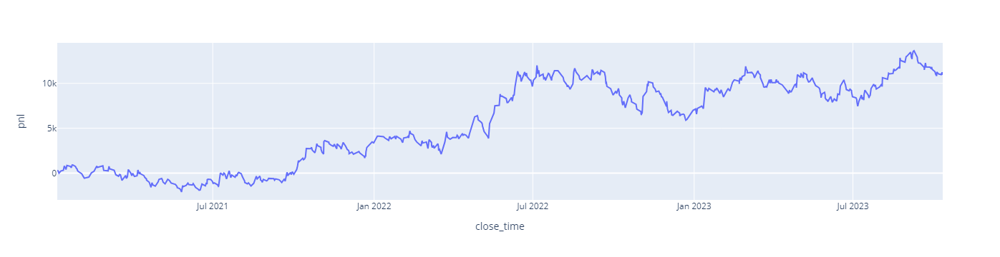

In [47]:
import plotly.express as px

px.line(trades, x='close_time', y='pnl')

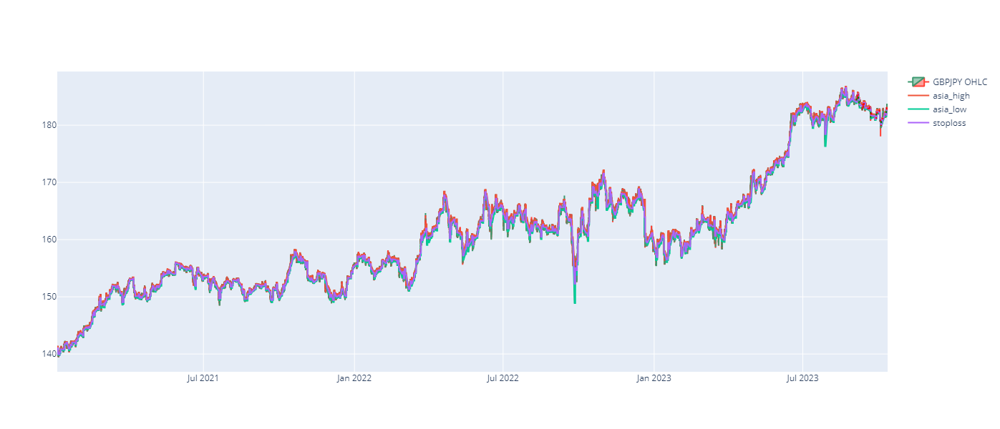

In [49]:
import plotly.graph_objects as go

fig = go.Figure(
    data=[go.Candlestick(
        name='GBPJPY OHLC',
        x=df['time'],
        open=df['open'],
        high=df['high'],
        low=df['low'],
        close=df['close'],
    )]
)

fig.update_layout(xaxis_rangeslider_visible=False, height=600)
fig.add_trace(go.Scatter(name='asia_high', x=df['time'], y=df['session_high']))
fig.add_trace(go.Scatter(name='asia_low', x=df['time'], y=df['session_low']))
fig.add_trace(go.Scatter(name='stoploss', x=df['time'], y=df['stoploss']))


# visualizing the trades
for i, trade in trades.tail(30).iterrows():
    
    color = 'green' if trade['profit'] > 0 else 'red'
    fig.add_shape(type="line",
        x0=trade['open_time'], y0=trade['open_price'], x1=trade['close_time'], y1=trade['close_price'],
        line=dict(
            color=color,
            width=2,
            dash="dot",
        )
    )
    
    
fig